In [1]:
# DASK client set

import os
import sys
from dask.distributed import Client

client = Client(scheduler_file='/proj/kimyy/Dropbox/source/python/all/mpi/scheduler.json')  

def setup_module_path():
    module_path = '/proj/kimyy/Dropbox/source/python/all/Modules/CESM2'
    if module_path not in sys.path:
        sys.path.append(module_path)

client.run(setup_module_path)

client

notebook_path = os.path.abspath(".")
_, _, relative_path = notebook_path.partition('/all/')
relative_path = '/all/' + relative_path
relative_path

'/all/Model/CESM2/Earth_System_Predictability/ASSM/Aleph'

In [2]:
# load public modules

import xarray as xr
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.pyplot as plt
from scipy import stats
from scipy.interpolate import griddata
import warnings
warnings.simplefilter(action='ignore')
import pandas as pd
import cftime
import pop_tools
import time
import subprocess
import re as re_mod
import cftime
import datetime
import xcesm

In [3]:
# load private modules

import sys
sys.path.append('/proj/kimyy/Dropbox/source/python/all/Modules/CESM2')
from KYY_CESM2_preprocessing import CESM2_config


In [4]:
ds_grid = pop_tools.get_grid('POP_gx1v7')

# Physical variables
cfg_var_HBLT=CESM2_config()
cfg_var_HBLT.year_s=1960
cfg_var_HBLT.year_e=2020
cfg_var_HBLT.setvar('HBLT')

cfg_var_TEMP=CESM2_config()
cfg_var_TEMP.year_s=1960
cfg_var_TEMP.year_e=2020
cfg_var_TEMP.setvar('TEMP')

cfg_var_TAUX=CESM2_config()
cfg_var_TAUX.year_s=1960
cfg_var_TAUX.year_e=2020
cfg_var_TAUX.setvar('TAUX')

cfg_var_TAUY=CESM2_config()
cfg_var_TAUY.year_s=1960
cfg_var_TAUY.year_e=2020
cfg_var_TAUY.setvar('TAUY')

cfg_var_U=CESM2_config()
cfg_var_U.year_s=1960
cfg_var_U.year_e=2020
cfg_var_U.setvar('U')

cfg_var_V=CESM2_config()
cfg_var_V.year_s=1960
cfg_var_V.year_e=2020
cfg_var_V.setvar('V')

cfg_var_U10=CESM2_config()
cfg_var_U10.year_s=1960
cfg_var_U10.year_e=2020
cfg_var_U10.setvar('U10')

cfg_var_UBOT=CESM2_config()
cfg_var_UBOT.year_s=1960
cfg_var_UBOT.year_e=2020
cfg_var_UBOT.setvar('UBOT')

cfg_var_VBOT=CESM2_config()
cfg_var_VBOT.year_s=1960
cfg_var_VBOT.year_e=2020
cfg_var_VBOT.setvar('VBOT')

# Biogeochemical variables
cfg_var_photoC_TOT_zint_100m=CESM2_config()
cfg_var_photoC_TOT_zint_100m.year_s=1960
cfg_var_photoC_TOT_zint_100m.year_e=2020
cfg_var_photoC_TOT_zint_100m.setvar('photoC_TOT_zint_100m')

cfg_var_spChl=CESM2_config()
cfg_var_spChl.year_s=1960
cfg_var_spChl.year_e=2020
cfg_var_spChl.setvar('spChl')
# cfg_var_spChl.list()

cfg_var_diatChl=CESM2_config()
cfg_var_diatChl.year_s=1960
cfg_var_diatChl.year_e=2020
cfg_var_diatChl.setvar('diatChl')

cfg_var_diazChl=CESM2_config()
cfg_var_diazChl.year_s=1960
cfg_var_diazChl.year_e=2020
cfg_var_diazChl.setvar('diazChl')

cfg_var_diatC=CESM2_config()
cfg_var_diatC.year_s=1960
cfg_var_diatC.year_e=2020
cfg_var_diatC.setvar('diatC')

cfg_var_spC=CESM2_config()
cfg_var_spC.year_s=1960
cfg_var_spC.year_e=2020
cfg_var_spC.setvar('spC')

cfg_var_diazC=CESM2_config()
cfg_var_diazC.year_s=1960
cfg_var_diazC.year_e=2020
cfg_var_diazC.setvar('diazC')

cfg_var_zooC=CESM2_config()
cfg_var_zooC.year_s=1960
cfg_var_zooC.year_e=2020
cfg_var_zooC.setvar('zooC')

cfg_var_NO3=CESM2_config()
cfg_var_NO3.year_s=1960
cfg_var_NO3.year_e=2020
cfg_var_NO3.setvar('NO3')

cfg_var_Fe=CESM2_config()
cfg_var_Fe.year_s=1960
cfg_var_Fe.year_e=2020
cfg_var_Fe.setvar('Fe')

cfg_var_PO4=CESM2_config()
cfg_var_PO4.year_s=1960
cfg_var_PO4.year_e=2020
cfg_var_PO4.setvar('PO4')

cfg_var_WT_PO4=CESM2_config()
cfg_var_WT_PO4.year_s=1960
cfg_var_WT_PO4.year_e=2020
cfg_var_WT_PO4.setvar('WT_PO4')


cfg_var_spChl_SURF=CESM2_config()
cfg_var_spChl_SURF.year_s=1960
cfg_var_spChl_SURF.year_e=2020
cfg_var_spChl_SURF.setvar('spChl_SURF')
cfg_var_spChl_SURF.list()

start_date = cftime.DatetimeNoLeap(cfg_var_spChl.year_s, 1, 1)
end_date = cftime.DatetimeNoLeap(cfg_var_spChl.year_e+1, 1, 1)


{'codebase': 'e21',
 'comp': 'ocn',
 'compset': 'b',
 'dimension': 'time '
              'nlat '
              'nlon',
 'long_name': 'Small '
              'Phyto '
              'Chlorophyll '
              'Surface '
              'Value',
 'model': 'pop.h',
 'ndim': 3,
 'resol': 'f09_g17',
 'tfreq': 'day_1',
 'unit': 'mg/m^3',
 'var': 'spChl_SURF',
 'year_e': 2020,
 'year_s': 1960}


In [100]:
# define preprocessing function

exceptcv=['time','lon','lat', 'TLONG', 'TLAT', 'z_t', 'lev',
          cfg_var_HBLT.var, cfg_var_TEMP.var, cfg_var_TAUX.var, cfg_var_TAUY.var, 
          cfg_var_U10.var, cfg_var_U.var, cfg_var_V.var, cfg_var_UBOT.var, cfg_var_VBOT.var,
          cfg_var_diatChl.var, cfg_var_spChl.var, cfg_var_diazChl.var, 
          cfg_var_diatC.var, cfg_var_spC.var, cfg_var_diazC.var, cfg_var_zooC.var, 
          cfg_var_NO3.var, cfg_var_Fe.var, cfg_var_PO4.var, cfg_var_WT_PO4.var, 
          cfg_var_spChl_SURF.var, cfg_var_photoC_TOT_zint_100m.var]

def process_coords(ds, sd, ed, varname, drop=True, except_coord_vars=exceptcv):
    import xcesm
    import numpy as np
    
    """Preprocessor function to drop all non-dim coords, which slows down concatenation."""
    coord_vars = []
    for v in np.array(ds.coords) :
        if not v in except_coord_vars:
            coord_vars += [v]
    for v in np.array(ds.data_vars) :
        if not v in except_coord_vars:
            coord_vars += [v]
    
    if drop:
        ds= ds.drop(coord_vars)

        # ds= ds.sel(time=slice(sd, ed)).isel(z_t=0)
        
        ds_rgd = ds[varname].utils.regrid()
        return ds_rgd
    else:
        return ds.set_coords(coord_vars)

def process_coords_bgc_surface(ds, sd, ed, varname, drop=True, except_coord_vars=exceptcv):
    import xcesm
    import numpy as np
    
    """Preprocessor function to drop all non-dim coords, which slows down concatenation."""
    coord_vars = []
    for v in np.array(ds.coords) :
        if not v in except_coord_vars:
            coord_vars += [v]
    for v in np.array(ds.data_vars) :
        if not v in except_coord_vars:
            coord_vars += [v]
    
    if drop:
        ds= ds.drop(coord_vars)
        ds= ds.sel(time=slice(sd, ed)).isel(z_t_150m=0)
        ds_rgd = ds[varname].utils.regrid()
        return ds_rgd
    else:
        return ds.set_coords(coord_vars)

def process_coords_obs(ds, sd, ed, varname, drop=True, except_coord_vars=exceptcv):
    import xcesm
    import numpy as np
    
    """Preprocessor function to drop all non-dim coords, which slows down concatenation."""
    
    if drop:
        # ds= ds.sel(time=slice(sd, ed)).isel(z_t=0)
        ds_rgd = ds[varname].utils.regrid()
        return ds_rgd
    else:
        return ds.set_coords(coord_vars)


def process_coords_obs_atm(ds, sd, ed, varname, drop=True, except_coord_vars=exceptcv):
    """Preprocessor function to drop all non-dim coords, which slows down concatenation."""
    
    if drop:
        # ds= ds.sel(time=slice(sd, ed)).isel(z_t=0)
        # ds_rgd = ds[varname].utils.regrid()
        return ds
    else:
        return ds.set_coords(coord_vars)


def process_coords_atm(ds, sd, ed, varname, drop=True, except_coord_vars=exceptcv):
    import xcesm
    import numpy as np
    
    """Preprocessor function to drop all non-dim coords, which slows down concatenation."""
    coord_vars = []
    for v in np.array(ds.coords) :
        if not v in except_coord_vars:
            coord_vars += [v]
    for v in np.array(ds.data_vars) :
        if not v in except_coord_vars:
            coord_vars += [v]
    
    if drop:
        ds= ds.drop(coord_vars)

        # ds= ds.sel(time=slice(sd, ed)).isel(z_t=0)
        
        # ds_rgd = ds[varname].utils.regrid()
        return ds
    else:
        return ds.set_coords(coord_vars)

def process_coords_atm_surf(ds, sd, ed, varname, drop=True, except_coord_vars=exceptcv):
    import xcesm
    import numpy as np
    
    """Preprocessor function to drop all non-dim coords, which slows down concatenation."""
    coord_vars = []
    for v in np.array(ds.coords) :
        if not v in except_coord_vars:
            coord_vars += [v]
    for v in np.array(ds.data_vars) :
        if not v in except_coord_vars:
            coord_vars += [v]
    
    if drop:
        ds= ds.drop(coord_vars)
        ds= ds.isel(lev=-1)

        # ds= ds.sel(time=slice(sd, ed)).isel(z_t=0)
        
        # ds_rgd = ds[varname].utils.regrid()
        return ds
    else:
        return ds.set_coords(coord_vars)


def process_coords_d2y(ds, sd, ed, drop=True, except_coord_vars=exceptcv):
    """Preprocessor function to drop all non-dim coords, which slows down concatenation."""
    coord_vars = []
    for v in np.array(ds.coords) :
        if not v in except_coord_vars:
            coord_vars += [v]
    for v in np.array(ds.data_vars) :
        if not v in except_coord_vars:
            coord_vars += [v]
    
    if drop:
        ds= ds.drop(coord_vars)
        ds= ds.sel(time=slice(sd, ed))
        # ds= ds.sel(time=slice(sd, ed)).isel(lev=slice(1, 11))
        dt_array = np.full(ds.time_values.shape, datetime.timedelta(days=0.5))
        new_time= ds.time_values - dt_array
        ds = ds.assign(time_values=new_time)
        ds = ds.groupby('time.year').mean(dim='time', skipna=True)
        return ds
    else:
        return ds.set_coords(coord_vars)


def process_coords_hcst(ds, drop=True, except_coord_vars=exceptcv):
    """Preprocessor function to drop all non-dim coords, which slows down concatenation."""
    coord_vars = []
    for v in np.array(ds.coords) :
        if not v in except_coord_vars:
            coord_vars += [v]
    for v in np.array(ds.data_vars) :
        if not v in except_coord_vars:
            coord_vars += [v]
    
    if drop:
        ds= ds.drop(coord_vars)
        return ds
    else:
        return ds.set_coords(coord_vars)



In [15]:
# 1231.012
# UBOT, U1000 -> SSP 370 only
# U, TAUX, TAUY -> historical only


cfg_var_UBOT.LE_path_load(cfg_var_UBOT.var, 'day_1')
cfg_var_UBOT.LE_file_list[0][11]


['/proj/jedwards/archive/b.e21.BSSP370smbb.f09_g17.LE2-1231.012/atm/proc/tseries/day_1/b.e21.BSSP370smbb.f09_g17.LE2-1231.012.cam.h1.UBOT.20150101-20241231.nc']

In [6]:

cfg_var_HBLT.ODA_path_load(cfg_var_HBLT.var)
cfg_var_HBLT.ADA_path_load(cfg_var_HBLT.var)

cfg_var_TEMP.ODA_path_load(cfg_var_TEMP.var)
cfg_var_TEMP.ADA_path_load(cfg_var_TEMP.var)

cfg_var_TAUX.ODA_path_load(cfg_var_TAUX.var)
cfg_var_TAUX.ADA_path_load(cfg_var_TAUX.var)

cfg_var_TAUY.ODA_path_load(cfg_var_TAUY.var)
cfg_var_TAUY.ADA_path_load(cfg_var_TAUY.var)

cfg_var_U.ODA_path_load(cfg_var_U.var)
cfg_var_U.ADA_path_load(cfg_var_U.var)

cfg_var_V.ODA_path_load(cfg_var_V.var)
cfg_var_V.ADA_path_load(cfg_var_V.var)

cfg_var_UBOT.ODA_path_load(cfg_var_UBOT.var)
cfg_var_UBOT.ADA_path_load(cfg_var_UBOT.var)

cfg_var_VBOT.ODA_path_load(cfg_var_VBOT.var)
cfg_var_VBOT.ADA_path_load(cfg_var_VBOT.var)

cfg_var_photoC_TOT_zint_100m.ODA_path_load(cfg_var_photoC_TOT_zint_100m.var)
cfg_var_photoC_TOT_zint_100m.ADA_path_load(cfg_var_photoC_TOT_zint_100m.var)

cfg_var_diatChl.ODA_path_load(cfg_var_diatChl.var)
cfg_var_diatChl.ADA_path_load(cfg_var_diatChl.var)
cfg_var_spChl.ODA_path_load(cfg_var_spChl.var)
cfg_var_spChl.ADA_path_load(cfg_var_spChl.var)
cfg_var_diazChl.ODA_path_load(cfg_var_diazChl.var)
cfg_var_diazChl.ADA_path_load(cfg_var_diazChl.var)

cfg_var_diatC.ODA_path_load(cfg_var_diatC.var)
cfg_var_diatC.ADA_path_load(cfg_var_diatC.var)
cfg_var_spC.ODA_path_load(cfg_var_spC.var)
cfg_var_spC.ADA_path_load(cfg_var_spC.var)
cfg_var_diazC.ODA_path_load(cfg_var_diazC.var)
cfg_var_diazC.ADA_path_load(cfg_var_diazC.var)

cfg_var_zooC.ODA_path_load(cfg_var_zooC.var)
cfg_var_zooC.ADA_path_load(cfg_var_zooC.var)

cfg_var_NO3.ODA_path_load(cfg_var_NO3.var)
cfg_var_NO3.ADA_path_load(cfg_var_NO3.var)

cfg_var_Fe.ODA_path_load(cfg_var_Fe.var)
cfg_var_Fe.ADA_path_load(cfg_var_Fe.var)

cfg_var_PO4.ODA_path_load(cfg_var_PO4.var)
cfg_var_PO4.ADA_path_load(cfg_var_PO4.var)

cfg_var_WT_PO4.ODA_path_load(cfg_var_WT_PO4.var)
cfg_var_WT_PO4.ADA_path_load(cfg_var_WT_PO4.var)


In [7]:
cfg_var_spChl.ODA_file_list[0][5][-5:-3]
cfg_var_spChl.ADA_file_list[0][5][-5:-3]


['/mnt/lustre/proj/earth.system.predictability/ATM_TEST/EXP_ALL_timeseries/archive/b.e21.BHISTsmbb.f09_g17.assm.projdv7.3_ba-20p1/ocn/proc/tseries/month_1/b.e21.BHISTsmbb.f09_g17.assm.projdv7.3_ba-20p1.pop.h.spChl.200001-200412.nc',
 '/mnt/lustre/proj/earth.system.predictability/ATM_TEST/EXP_ALL_timeseries/archive/b.e21.BHISTsmbb.f09_g17.assm.projdv7.3_ba-20p1/ocn/proc/tseries/month_1/b.e21.BHISTsmbb.f09_g17.assm.projdv7.3_ba-20p1.pop.h.spChl.200501-200912.nc']

In [8]:
# cfg_var_spChl_SURF.LE_path_load(cfg_var_spChl_SURF.var)
# cfg_var_spChl_SURF.LE_file_list[0][0][-3]

In [82]:
# Read NPP

# Read ODA dataset (photoC_TOT_zint_100m)

start_time = time.time()

cfg_var_photoC_TOT_zint_100m.ODA_path_load(cfg_var_photoC_TOT_zint_100m.var)

tmp_comp=cfg_var_photoC_TOT_zint_100m.comp
cfg_var_photoC_TOT_zint_100m.ODA_ds = []
# # 2001~2010
# cfg_var_photoC_TOT_zint_100m.ODA_ds = xr.open_mfdataset(cfg_var_photoC_TOT_zint_100m.ODA_file_list[0][5][-5:-3], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords(ds, start_date, end_date, 'photoC_TOT_zint_100m'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_photoC_TOT_zint_100m.ODA_ds = xr.open_mfdataset(cfg_var_photoC_TOT_zint_100m.ODA_file_list[0][5], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords(ds, start_date, end_date, 'photoC_TOT_zint_100m'),
                       decode_cf=True, 
                       decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_photoC_TOT_zint_100m.ODA_ds=cfg_var_photoC_TOT_zint_100m.ODA_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading ODA, ' + ': ' + str(elapsed_time))



# Read ADA dataset (photoC_TOT_zint_100m)

start_time = time.time()

cfg_var_photoC_TOT_zint_100m.ADA_path_load(cfg_var_photoC_TOT_zint_100m.var)

tmp_comp=cfg_var_photoC_TOT_zint_100m.comp
cfg_var_photoC_TOT_zint_100m.ADA_ds = []
# # 2001~2010
# cfg_var_photoC_TOT_zint_100m.ADA_ds = xr.open_mfdataset(cfg_var_photoC_TOT_zint_100m.ADA_file_list[0][5][-5:-3], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords(ds, start_date, end_date, 'photoC_TOT_zint_100m'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_photoC_TOT_zint_100m.ADA_ds = xr.open_mfdataset(cfg_var_photoC_TOT_zint_100m.ADA_file_list[0][5], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords(ds, start_date, end_date, 'photoC_TOT_zint_100m'),
                       decode_cf=True, 
                       decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_photoC_TOT_zint_100m.ADA_ds=cfg_var_photoC_TOT_zint_100m.ADA_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading ADA, ' + ': ' + str(elapsed_time))

# Read OBS dataset (photoC_TOT_zint_100m)

start_time = time.time()

cfg_var_photoC_TOT_zint_100m.OBS_path_load(cfg_var_photoC_TOT_zint_100m.var)
# cfg_var_photoC_TOT_zint_100m.OBS_file_list[0]
tmp_comp=cfg_var_photoC_TOT_zint_100m.comp
cfg_var_photoC_TOT_zint_100m.OBS_ds = []
cfg_var_photoC_TOT_zint_100m.OBS_ds = xr.open_mfdataset(cfg_var_photoC_TOT_zint_100m.OBS_file_list[0][0],
                       preprocess=lambda ds: process_coords_obs(ds, start_date, end_date, 'PP'))

cfg_var_photoC_TOT_zint_100m.OBS_ds = cfg_var_photoC_TOT_zint_100m.OBS_ds.rename({cfg_var_photoC_TOT_zint_100m.OBS_var: cfg_var_photoC_TOT_zint_100m.var})


end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_photoC_TOT_zint_100m.OBS_ds=cfg_var_photoC_TOT_zint_100m.OBS_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading OBS, ' + ': ' + str(elapsed_time))


# Read LE dataset (photoC_TOT_zint_100m)

start_time = time.time()

cfg_var_photoC_TOT_zint_100m.LE_path_load(cfg_var_photoC_TOT_zint_100m.var)
# cfg_var_photoC_TOT_zint_100m.LE_file_list[0][11] # projd 20p1 = 1231.012


tmp_comp=cfg_var_photoC_TOT_zint_100m.comp
cfg_var_photoC_TOT_zint_100m.LE_ds = []
# # 2000~2014
# cfg_var_photoC_TOT_zint_100m.LE_ds = xr.open_mfdataset(cfg_var_photoC_TOT_zint_100m.LE_file_list[0][11][-3:-2], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords(ds, start_date, end_date, 'photoC_TOT_zint_100m'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_photoC_TOT_zint_100m.LE_ds = xr.open_mfdataset(cfg_var_photoC_TOT_zint_100m.LE_file_list[0][11], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords(ds, start_date, end_date, 'photoC_TOT_zint_100m'),
                       decode_cf=True, 
                       decode_times=True)

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_photoC_TOT_zint_100m.LE_ds=cfg_var_photoC_TOT_zint_100m.LE_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading LE, ' + ': ' + str(elapsed_time))

elasped time for reading ODA, : 13.585070610046387
elasped time for reading ADA, : 9.919987201690674
elasped time for reading OBS, : 57.71988582611084
elasped time for reading LE, : 14.822411298751831


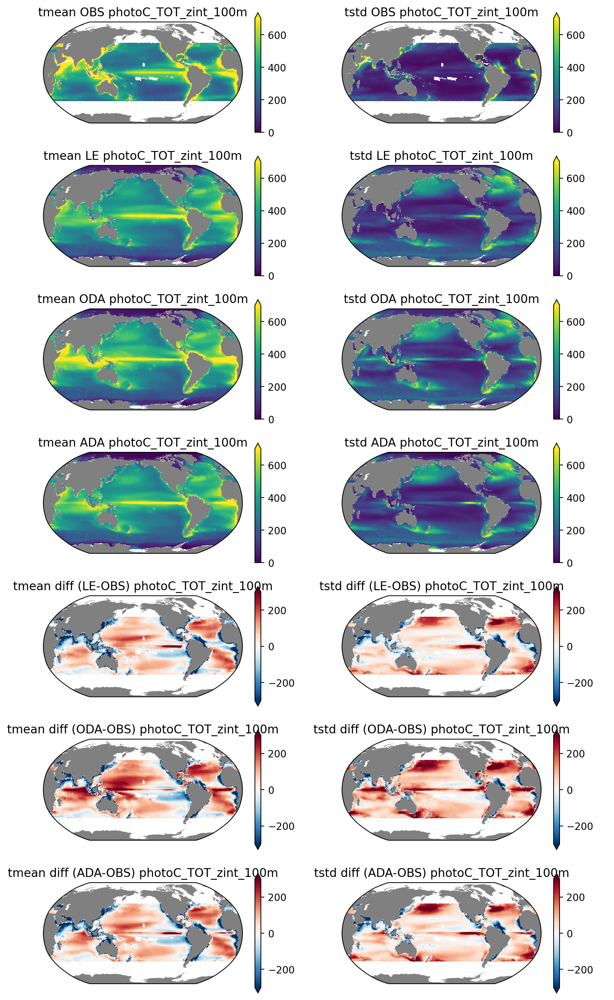

In [111]:

# tmp_data = cfg_var_photoC_TOT_zint_100m.ADA_ds.mean(dim='time') - cfg_var_photoC_TOT_zint_100m.ODA_ds.mean(dim='time')
# tmp_data['photoC_TOT_zint_100m'].plot.pcolormesh(vmin=-0.03, vmax=0.03, extend='both', cmap=plt.get_cmap('RdBu_r'))

# OBS : mg C m⁻² day⁻¹
# Model : nmol/cm^2/s
# Conversion: nmol → mol → g → mg, cm² → m², s → day
# Total factor = 1e4 (cm²→m²) × 86,400 (s→day) × 1e-9 (nmol→mol) × 12,000 (mol C→mg C) = 10,368
Tf = 10368

land_feature = cfeature.LAND.with_scale('110m')

projection = ccrs.Robinson(central_longitude=200)
fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(10, 18), # width , height
             dpi=200, facecolor='w', edgecolor='k', subplot_kw={'projection': projection}, constrained_layout=False)


# data_array=cfg_var_photoC_TOT_zint_100m.OBS_ds.mean(dim='time') # skip nan
data_array = cfg_var_photoC_TOT_zint_100m.OBS_ds.mean(dim='time', skipna=True).where(~cfg_var_photoC_TOT_zint_100m.OBS_ds.isnull().any(dim='time')) # consider nan

plt1=data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[0,0], transform=ccrs.PlateCarree(), 
                                 cmap= plt.get_cmap('viridis'), add_colorbar=True, extend='max', vmin=0, vmax=700,
                                cbar_kwargs={'orientation':'vertical',"label": " ", 'spacing': 'proportional'})

axes[0,0].set_title('tmean OBS ' + cfg_var_photoC_TOT_zint_100m.var)
axes[0,0].add_feature(land_feature, facecolor='gray', edgecolor='none')


data_array=cfg_var_photoC_TOT_zint_100m.LE_ds.mean(dim='time')*Tf
plt1=data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[1,0], transform=ccrs.PlateCarree(), 
                                 cmap= plt.get_cmap('viridis'), add_colorbar=True, extend='max', vmin=0, vmax=700,
                                cbar_kwargs={'orientation':'vertical',"label": " ", 'spacing': 'proportional'})

axes[1,0].set_title('tmean LE ' + cfg_var_photoC_TOT_zint_100m.var)
axes[1,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

data_array=cfg_var_photoC_TOT_zint_100m.ODA_ds.mean(dim='time')*Tf
plt1=data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[2,0], transform=ccrs.PlateCarree(), 
                                 cmap= plt.get_cmap('viridis'), add_colorbar=True, extend='max', vmin=0, vmax=700,
                                cbar_kwargs={'orientation':'vertical',"label": " ", 'spacing': 'proportional'})

axes[2,0].set_title('tmean ODA ' + cfg_var_photoC_TOT_zint_100m.var)
axes[2,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

data_array=cfg_var_photoC_TOT_zint_100m.ADA_ds.mean(dim='time')*Tf
plt1=data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[3,0], transform=ccrs.PlateCarree(), 
                                 cmap= plt.get_cmap('viridis'), add_colorbar=True, extend='max', vmin=0, vmax=700,
                                cbar_kwargs={'orientation':'vertical',"label": " ", 'spacing': 'proportional'})

axes[3,0].set_title('tmean ADA ' + cfg_var_photoC_TOT_zint_100m.var)
axes[3,0].add_feature(land_feature, facecolor='gray', edgecolor='none')



# ADA-ODA
# data_array=cfg_var_photoC_TOT_zint_100m.ADA_ds.mean(dim='time')*Tf - cfg_var_photoC_TOT_zint_100m.ODA_ds.mean(dim='time')*Tf
# plt1=data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[4,0], transform=ccrs.PlateCarree(), 
#                                  cmap= plt.get_cmap('RdBu_r'), add_colorbar=True, extend='both', vmin=-300, vmax=300,
#                                 cbar_kwargs={'orientation':'vertical',"label": " ", 'spacing': 'proportional'})

# axes[4,0].set_title('tmean diff (ADA-ODA) ' + cfg_var_photoC_TOT_zint_100m.var)
# axes[4,0].add_feature(land_feature, facecolor='gray', edgecolor='none')


# LE - OBS
data_array=cfg_var_photoC_TOT_zint_100m.LE_ds.mean(dim='time')*Tf - cfg_var_photoC_TOT_zint_100m.OBS_ds.mean(dim='time', skipna=True).where(~cfg_var_photoC_TOT_zint_100m.OBS_ds.isnull().any(dim='time'))
plt1=data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[4,0], transform=ccrs.PlateCarree(), 
                                 cmap= plt.get_cmap('RdBu_r'), add_colorbar=True, extend='both', vmin=-300, vmax=300,
                                cbar_kwargs={'orientation':'vertical',"label": " ", 'spacing': 'proportional'})

axes[4,0].set_title('tmean diff (LE-OBS) ' + cfg_var_photoC_TOT_zint_100m.var)
axes[4,0].add_feature(land_feature, facecolor='gray', edgecolor='none')


# ODA - OBS
data_array=cfg_var_photoC_TOT_zint_100m.ODA_ds.mean(dim='time')*Tf - cfg_var_photoC_TOT_zint_100m.OBS_ds.mean(dim='time', skipna=True).where(~cfg_var_photoC_TOT_zint_100m.OBS_ds.isnull().any(dim='time'))
plt1=data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[5,0], transform=ccrs.PlateCarree(), 
                                 cmap= plt.get_cmap('RdBu_r'), add_colorbar=True, extend='both', vmin=-300, vmax=300,
                                cbar_kwargs={'orientation':'vertical',"label": " ", 'spacing': 'proportional'})

axes[5,0].set_title('tmean diff (ODA-OBS) ' + cfg_var_photoC_TOT_zint_100m.var)
axes[5,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

# ADA - OBS
data_array=cfg_var_photoC_TOT_zint_100m.ADA_ds.mean(dim='time')*Tf - cfg_var_photoC_TOT_zint_100m.OBS_ds.mean(dim='time', skipna=True).where(~cfg_var_photoC_TOT_zint_100m.OBS_ds.isnull().any(dim='time'))
plt1=data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[6,0], transform=ccrs.PlateCarree(), 
                                 cmap= plt.get_cmap('RdBu_r'), add_colorbar=True, extend='both', vmin=-300, vmax=300,
                                cbar_kwargs={'orientation':'vertical',"label": " ", 'spacing': 'proportional'})

axes[6,0].set_title('tmean diff (ADA-OBS) ' + cfg_var_photoC_TOT_zint_100m.var)
axes[6,0].add_feature(land_feature, facecolor='gray', edgecolor='none')



# stds
# === OBS ===
data_array = cfg_var_photoC_TOT_zint_100m.OBS_ds.std(dim='time', skipna=True).where(
    ~cfg_var_photoC_TOT_zint_100m.OBS_ds.isnull().any(dim='time')
)
plt1 = data_array['photoC_TOT_zint_100m'].plot.pcolormesh(
    x='lon', y='lat', ax=axes[0,1], transform=ccrs.PlateCarree(),
    cmap=plt.get_cmap('viridis'), add_colorbar=True, extend='max', vmin=0, vmax=700,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'}
)
axes[0,1].set_title('tstd OBS ' + cfg_var_photoC_TOT_zint_100m.var)
axes[0,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === LE ===
data_array = (cfg_var_photoC_TOT_zint_100m.LE_ds * Tf).std(dim='time')
plt1 = data_array['photoC_TOT_zint_100m'].plot.pcolormesh(
    x='lon', y='lat', ax=axes[1,1], transform=ccrs.PlateCarree(),
    cmap=plt.get_cmap('viridis'), add_colorbar=True, extend='max', vmin=0, vmax=700,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'}
)
axes[1,1].set_title('tstd LE ' + cfg_var_photoC_TOT_zint_100m.var)
axes[1,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === ODA ===
data_array = (cfg_var_photoC_TOT_zint_100m.ODA_ds * Tf).std(dim='time')
plt1 = data_array['photoC_TOT_zint_100m'].plot.pcolormesh(
    x='lon', y='lat', ax=axes[2,1], transform=ccrs.PlateCarree(),
    cmap=plt.get_cmap('viridis'), add_colorbar=True, extend='max', vmin=0, vmax=700,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'}
)
axes[2,1].set_title('tstd ODA ' + cfg_var_photoC_TOT_zint_100m.var)
axes[2,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === ADA ===
data_array = (cfg_var_photoC_TOT_zint_100m.ADA_ds * Tf).std(dim='time')
plt1 = data_array['photoC_TOT_zint_100m'].plot.pcolormesh(
    x='lon', y='lat', ax=axes[3,1], transform=ccrs.PlateCarree(),
    cmap=plt.get_cmap('viridis'), add_colorbar=True, extend='max', vmin=0, vmax=700,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'}
)
axes[3,1].set_title('tstd ADA ' + cfg_var_photoC_TOT_zint_100m.var)
axes[3,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === LE - OBS ===
obs_std = cfg_var_photoC_TOT_zint_100m.OBS_ds.std(dim='time', skipna=True).where(
    ~cfg_var_photoC_TOT_zint_100m.OBS_ds.isnull().any(dim='time')
)
data_array = (cfg_var_photoC_TOT_zint_100m.LE_ds * Tf).std(dim='time') - obs_std
plt1 = data_array['photoC_TOT_zint_100m'].plot.pcolormesh(
    x='lon', y='lat', ax=axes[4,1], transform=ccrs.PlateCarree(),
    cmap=plt.get_cmap('RdBu_r'), add_colorbar=True, extend='both', vmin=-300, vmax=300,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'}
)
axes[4,1].set_title('tstd diff (LE-OBS) ' + cfg_var_photoC_TOT_zint_100m.var)
axes[4,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === ODA - OBS ===
data_array = (cfg_var_photoC_TOT_zint_100m.ODA_ds * Tf).std(dim='time') - obs_std
plt1 = data_array['photoC_TOT_zint_100m'].plot.pcolormesh(
    x='lon', y='lat', ax=axes[5,1], transform=ccrs.PlateCarree(),
    cmap=plt.get_cmap('RdBu_r'), add_colorbar=True, extend='both', vmin=-300, vmax=300,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'}
)
axes[5,1].set_title('tstd diff (ODA-OBS) ' + cfg_var_photoC_TOT_zint_100m.var)
axes[5,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === ADA - OBS ===
data_array = (cfg_var_photoC_TOT_zint_100m.ADA_ds * Tf).std(dim='time') - obs_std
plt1 = data_array['photoC_TOT_zint_100m'].plot.pcolormesh(
    x='lon', y='lat', ax=axes[6,1], transform=ccrs.PlateCarree(),
    cmap=plt.get_cmap('RdBu_r'), add_colorbar=True, extend='both', vmin=-300, vmax=300,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'}
)
axes[6,1].set_title('tstd diff (ADA-OBS) ' + cfg_var_photoC_TOT_zint_100m.var)
axes[6,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

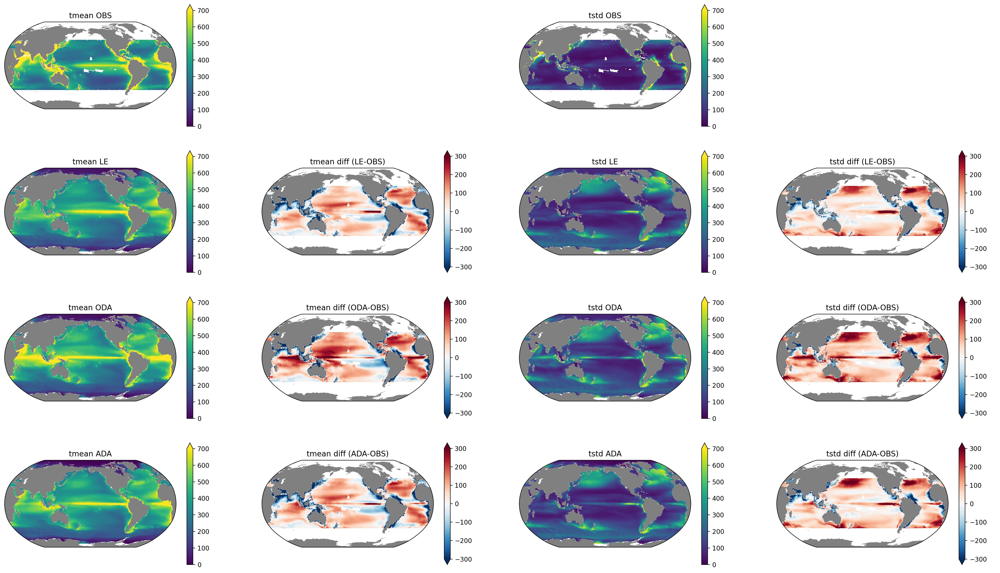

In [114]:
projection = ccrs.Robinson(central_longitude=200)
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(28, 16), dpi=200,
                         facecolor='w', edgecolor='k',
                         subplot_kw={'projection': projection},
                         constrained_layout=False)

# === 1열: tmean ===
data_array = cfg_var_photoC_TOT_zint_100m.OBS_ds.mean(dim='time', skipna=True).where(
    ~cfg_var_photoC_TOT_zint_100m.OBS_ds.isnull().any(dim='time'))
data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[0,0],
    transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=700,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
axes[0,0].set_title('tmean OBS')
axes[0,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_photoC_TOT_zint_100m.LE_ds, cfg_var_photoC_TOT_zint_100m.ODA_ds, cfg_var_photoC_TOT_zint_100m.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time')
    data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,0],
        transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=700,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,0].set_title(f'tmean {label}')
    axes[i,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 2열: tmean diff ===
obs_mean = cfg_var_photoC_TOT_zint_100m.OBS_ds.mean(dim='time', skipna=True).where(
    ~cfg_var_photoC_TOT_zint_100m.OBS_ds.isnull().any(dim='time'))

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_photoC_TOT_zint_100m.LE_ds, cfg_var_photoC_TOT_zint_100m.ODA_ds, cfg_var_photoC_TOT_zint_100m.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time') - obs_mean
    data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,1],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-300, vmax=300,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,1].set_title(f'tmean diff ({label}-OBS)')
    axes[i,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 3열: tstd ===
data_array = cfg_var_photoC_TOT_zint_100m.OBS_ds.std(dim='time', skipna=True).where(
    ~cfg_var_photoC_TOT_zint_100m.OBS_ds.isnull().any(dim='time'))
data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[0,2],
    transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=700,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
axes[0,2].set_title('tstd OBS')
axes[0,2].add_feature(land_feature, facecolor='gray', edgecolor='none')

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_photoC_TOT_zint_100m.LE_ds, cfg_var_photoC_TOT_zint_100m.ODA_ds, cfg_var_photoC_TOT_zint_100m.ADA_ds]):
    data_array = (ds * Tf).std(dim='time')
    data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,2],
        transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=700,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,2].set_title(f'tstd {label}')
    axes[i,2].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 4열: tstd diff ===
obs_std = cfg_var_photoC_TOT_zint_100m.OBS_ds.std(dim='time', skipna=True).where(
    ~cfg_var_photoC_TOT_zint_100m.OBS_ds.isnull().any(dim='time'))

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_photoC_TOT_zint_100m.LE_ds, cfg_var_photoC_TOT_zint_100m.ODA_ds, cfg_var_photoC_TOT_zint_100m.ADA_ds]):
    data_array = (ds * Tf).std(dim='time') - obs_std
    data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,3],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-300, vmax=300,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,3].set_title(f'tstd diff ({label}-OBS)')
    axes[i,3].add_feature(land_feature, facecolor='gray', edgecolor='none')


axes[0,1].remove()
axes[0,3].remove()

In [122]:
# Read ODA dataset (U)

start_time = time.time()

tmp_comp=cfg_var_U.comp
cfg_var_U.ODA_ds = []
# 2001 ~ 2010
cfg_var_U.ODA_ds = xr.open_mfdataset(cfg_var_U.ODA_file_list[0][5][-5:-3], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords_atm(ds, start_date, end_date, 'U'),
                       decode_cf=True, 
                       decode_times=True)
# # all years #impossible, memory issue
# cfg_var_U.ODA_ds = xr.open_mfdataset(cfg_var_U.ODA_file_list[0][5], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords_atm(ds, start_date, end_date, 'U'),
#                        decode_cf=True, 
#                        decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_U.ODA_ds=cfg_var_U.ODA_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading ODA, ' + ': ' + str(elapsed_time))

elasped time for reading ODA, : 20.930323123931885


In [ ]:
# # Read ODA dataset (UBOT)

# start_time = time.time()

# tmp_comp=cfg_var_UBOT.comp
# cfg_var_UBOT.ODA_ds = []
# # 2001 ~ 2010
# cfg_var_UBOT.ODA_ds = xr.open_mfdataset(cfg_var_UBOT.ODA_file_list[0][5][-5:-3], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords_atm(ds, start_date, end_date, 'UBOT'),
#                        decode_cf=True, 
#                        decode_times=True)
# # # all years #impossible, memory issue
# # cfg_var_UBOT.ODA_ds = xr.open_mfdataset(cfg_var_UBOT.ODA_file_list[0][5], 
# #                        chunks={'time': 5}, 
# #                        combine='nested',
# #                        parallel=True,
# #                        preprocess=lambda ds: process_coords_atm(ds, start_date, end_date, 'UBOT'),
# #                        decode_cf=True, 
# #                        decode_times=True)
    

# end_time = time.time()
# elapsed_time = end_time - start_time

# cfg_var_UBOT.ODA_ds=cfg_var_UBOT.ODA_ds.compute()

# end_time = time.time()
# elapsed_time = end_time - start_time
# print('elasped time for reading ODA, ' + ': ' + str(elapsed_time))






# Read LE dataset (UBOT)

start_time = time.time()

tmp_comp=cfg_var_UBOT.comp
cfg_var_UBOT.LE_ds = []
cfg_var_UBOT.LE_ds = xr.open_mfdataset(cfg_var_UBOT.LE_file_list[0][11], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords_atm(ds, start_date, end_date, 'UBOT'),
                       decode_cf=True, 
                       decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_UBOT.LE_ds=cfg_var_UBOT.LE_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading LE, ' + ': ' + str(elapsed_time))


# cfg_var_UBOT.ADA_path_load(cfg_var_UBOT.var, 'day_1')
# cfg_var_UBOT.ADA_file_list[0][5][-3:]

# Read ADA dataset (UBOT)

start_time = time.time()

tmp_comp=cfg_var_UBOT.comp
cfg_var_UBOT.ADA_ds = []
cfg_var_UBOT.ADA_ds = xr.open_mfdataset(cfg_var_UBOT.ADA_file_list[0][5][-3:], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords_atm(ds, start_date, end_date, 'UBOT'),
                       decode_cf=True, 
                       decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_UBOT.ADA_ds=cfg_var_UBOT.ADA_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading ADA, ' + ': ' + str(elapsed_time))



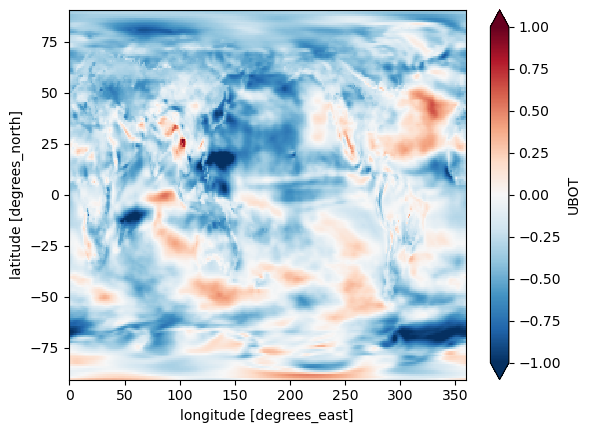

In [61]:
tmp_data = cfg_var_UBOT.ADA_ds.std(dim='time') - cfg_var_UBOT.ODA_ds.std(dim='time')
tmp_data['UBOT'].plot.pcolormesh(vmin=-1, vmax=1, extend='both', cmap=plt.get_cmap('RdBu_r'))

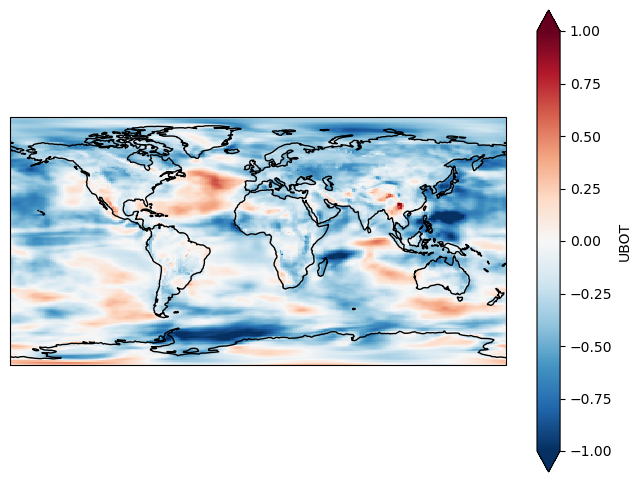

In [62]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# 계산 부분 (예시 그대로 유지)
tmp_data = cfg_var_UBOT.ADA_ds.std(dim='time') - cfg_var_UBOT.ODA_ds.std(dim='time')

# 그리기
fig, ax = plt.subplots(subplot_kw={'projection': ccrs.PlateCarree()}, figsize=(8, 6))

# pcolormesh에 ax 지정
tmp_data['UBOT'].plot.pcolormesh(
    ax=ax,
    transform=ccrs.PlateCarree(),  # 데이터 좌표계
    vmin=-1, vmax=1, cmap='RdBu_r',
    extend='both'
)

# Coastline 추가
ax.coastlines(resolution='110m', color='black', linewidth=1)

plt.show()

In [29]:
# Read U

# Read ODA dataset (U)

start_time = time.time()

cfg_var_U.ODA_path_load(cfg_var_U.var)

tmp_comp=cfg_var_U.comp
cfg_var_U.ODA_ds = []
# # 2001~2010
# cfg_var_U.ODA_ds = xr.open_mfdataset(cfg_var_U.ODA_file_list[0][5][-5:-3], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords_atm(ds, start_date, end_date, 'U'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_U.ODA_ds = xr.open_mfdataset(cfg_var_U.ODA_file_list[0][5], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'U'),
                       decode_cf=True, 
                       decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time


In [30]:
cfg_var_U.ODA_ds

<xarray.Dataset> Size: 175MB
Dimensions:  (lat: 192, lon: 288, time: 792)
Coordinates:
  * lat      (lat) float64 2kB -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
  * lon      (lon) float64 2kB 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * time     (time) object 6kB 1956-02-01 00:00:00 ... 2022-01-01 00:00:00
    lev      float64 8B 992.6
Data variables:
    U        (time, lat, lon) float32 175MB dask.array<chunksize=(65, 96, 144), meta=np.ndarray>
Attributes:
    Conventions:       CF-1.0
    source:            CAM
    case:              b.e21.BHISTsmbb.f09_g17.assm.en4.2_ba-20p1
    logname:           sunseon
    host:              mom2
    initial_file:      b.e21.BHISTsmbb.f09_g17.LE2-1231.012.cam.i.1951-01-01-...
    topography_file:   /mnt/lustre/share/CESM/cesm_input/atm/cam/topo/fv_0.9x...
    model_doi_url:     https://doi.org/10.5065/D67H1H0V
    time_period_freq:  month_1

In [32]:
# Read U

# Read ODA dataset (U)

start_time = time.time()

cfg_var_U.ODA_path_load(cfg_var_U.var)

tmp_comp=cfg_var_U.comp
cfg_var_U.ODA_ds = []
# # 2001~2010
# cfg_var_U.ODA_ds = xr.open_mfdataset(cfg_var_U.ODA_file_list[0][5][-5:-3], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'U'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_U.ODA_ds = xr.open_mfdataset(cfg_var_U.ODA_file_list[0][5], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'U'),
                       decode_cf=True, 
                       decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_U.ODA_ds=cfg_var_U.ODA_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading ODA, ' + ': ' + str(elapsed_time))



# Read ADA dataset (U)

start_time = time.time()

cfg_var_U.ADA_path_load(cfg_var_U.var)

tmp_comp=cfg_var_U.comp
cfg_var_U.ADA_ds = []
# # 2001~2010
# cfg_var_U.ADA_ds = xr.open_mfdataset(cfg_var_U.ADA_file_list[0][5][-5:-3], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'U'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_U.ADA_ds = xr.open_mfdataset(cfg_var_U.ADA_file_list[0][5], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'U'),
                       decode_cf=True, 
                       decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_U.ADA_ds=cfg_var_U.ADA_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading ADA, ' + ': ' + str(elapsed_time))



# Read LE dataset (U)

start_time = time.time()

cfg_var_U.LE_path_load(cfg_var_U.var)
# cfg_var_U.LE_file_list[0][11] # projd 20p1 = 1231.012


tmp_comp=cfg_var_U.comp
cfg_var_U.LE_ds = []
# # 2000~2014
# cfg_var_U.LE_ds = xr.open_mfdataset(cfg_var_U.LE_file_list[0][11][-3:-2], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'U'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_U.LE_ds = xr.open_mfdataset(cfg_var_U.LE_file_list[0][11], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'U'),
                       decode_cf=True, 
                       decode_times=True)

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_U.LE_ds=cfg_var_U.LE_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading LE, ' + ': ' + str(elapsed_time))




# Read OBS dataset (U)

start_time = time.time()

cfg_var_U.OBS_path_load(cfg_var_U.var)
# cfg_var_U.OBS_file_list[0]
tmp_comp=cfg_var_U.comp
cfg_var_U.OBS_ds = []
cfg_var_U.OBS_ds = xr.open_mfdataset(cfg_var_U.OBS_file_list[0][0],
                       preprocess=lambda ds: process_coords_obs_atm(ds, start_date, end_date, 'u10'))


cfg_var_U.OBS_ds = cfg_var_U.OBS_ds.rename({cfg_var_U.OBS_var: cfg_var_U.var})


end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_U.OBS_ds=cfg_var_U.OBS_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading OBS, ' + ': ' + str(elapsed_time))


elasped time for reading ODA, : 56.88595247268677
elasped time for reading ADA, : 49.90821957588196
elasped time for reading LE, : 36.42234539985657
elasped time for reading OBS, : 5.694486141204834


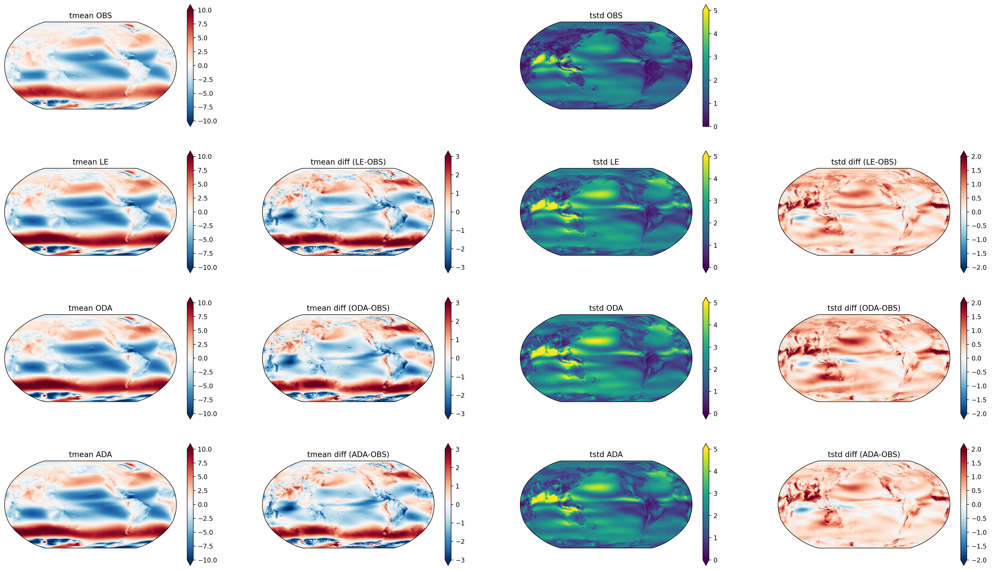

In [38]:
#U


Tf=1
land_feature = cfeature.LAND.with_scale('110m')

projection = ccrs.Robinson(central_longitude=200)
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(28, 16), dpi=200,
                         facecolor='w', edgecolor='k',
                         subplot_kw={'projection': projection},
                         constrained_layout=False)

# === 1열: tmean ===
data_array = cfg_var_U.OBS_ds.mean(dim='time', skipna=True).where(
    ~cfg_var_U.OBS_ds.isnull().any(dim='time'))
data_array['U'].plot.pcolormesh(x='lon', y='lat', ax=axes[0,0],
    transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-10, vmax=10,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
axes[0,0].set_title('tmean OBS')
axes[0,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_U.LE_ds, cfg_var_U.ODA_ds, cfg_var_U.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time')
    data_array['U'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,0],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-10, vmax=10,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,0].set_title(f'tmean {label}')
    axes[i,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 2열: tmean diff ===
obs_mean = cfg_var_U.OBS_ds.mean(dim='time', skipna=True).where(
    ~cfg_var_U.OBS_ds.isnull().any(dim='time'))

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_U.LE_ds, cfg_var_U.ODA_ds, cfg_var_U.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time') - obs_mean
    data_array['U'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,1],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-3, vmax=3,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,1].set_title(f'tmean diff ({label}-OBS)')
    axes[i,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 3열: tstd ===
data_array = cfg_var_U.OBS_ds.std(dim='time', skipna=True).where(
    ~cfg_var_U.OBS_ds.isnull().any(dim='time'))
data_array['U'].plot.pcolormesh(x='lon', y='lat', ax=axes[0,2],
    transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=5,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
axes[0,2].set_title('tstd OBS')
axes[0,2].add_feature(land_feature, facecolor='gray', edgecolor='none')

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_U.LE_ds, cfg_var_U.ODA_ds, cfg_var_U.ADA_ds]):
    data_array = (ds * Tf).std(dim='time')
    data_array['U'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,2],
        transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='both', vmin=0, vmax=5,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,2].set_title(f'tstd {label}')
    axes[i,2].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 4열: tstd diff ===
obs_std = cfg_var_U.OBS_ds.std(dim='time', skipna=True).where(
    ~cfg_var_U.OBS_ds.isnull().any(dim='time'))

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_U.LE_ds, cfg_var_U.ODA_ds, cfg_var_U.ADA_ds]):
    data_array = (ds * Tf).std(dim='time') - obs_std
    data_array['U'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,3],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-2, vmax=2,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,3].set_title(f'tstd diff ({label}-OBS)')
    axes[i,3].add_feature(land_feature, facecolor='gray', edgecolor='none')


axes[0,1].remove()
axes[0,3].remove()

In [39]:
# Read V

# Read ODA dataset (V)

start_time = time.time()

cfg_var_V.ODA_path_load(cfg_var_V.var)

tmp_comp=cfg_var_V.comp
cfg_var_V.ODA_ds = []
# # 2001~2010
# cfg_var_V.ODA_ds = xr.open_mfdataset(cfg_var_V.ODA_file_list[0][5][-5:-3], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'V'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_V.ODA_ds = xr.open_mfdataset(cfg_var_V.ODA_file_list[0][5], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'V'),
                       decode_cf=True, 
                       decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_V.ODA_ds=cfg_var_V.ODA_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading ODA, ' + ': ' + str(elapsed_time))



# Read ADA dataset (V)

start_time = time.time()

cfg_var_V.ADA_path_load(cfg_var_V.var)

tmp_comp=cfg_var_V.comp
cfg_var_V.ADA_ds = []
# # 2001~2010
# cfg_var_V.ADA_ds = xr.open_mfdataset(cfg_var_V.ADA_file_list[0][5][-5:-3], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'V'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_V.ADA_ds = xr.open_mfdataset(cfg_var_V.ADA_file_list[0][5], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'V'),
                       decode_cf=True, 
                       decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_V.ADA_ds=cfg_var_V.ADA_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading ADA, ' + ': ' + str(elapsed_time))



# Read LE dataset (V)

start_time = time.time()

cfg_var_V.LE_path_load(cfg_var_V.var)
# cfg_var_V.LE_file_list[0][11] # projd 20p1 = 1231.012


tmp_comp=cfg_var_V.comp
cfg_var_V.LE_ds = []
# # 2000~2014
# cfg_var_V.LE_ds = xr.open_mfdataset(cfg_var_V.LE_file_list[0][11][-3:-2], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'V'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_V.LE_ds = xr.open_mfdataset(cfg_var_V.LE_file_list[0][11], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'V'),
                       decode_cf=True, 
                       decode_times=True)

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_V.LE_ds=cfg_var_V.LE_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading LE, ' + ': ' + str(elapsed_time))




# Read OBS dataset (V)

start_time = time.time()

cfg_var_V.OBS_path_load(cfg_var_V.var)
# cfg_var_V.OBS_file_list[0]
tmp_comp=cfg_var_V.comp
cfg_var_V.OBS_ds = []
cfg_var_V.OBS_ds = xr.open_mfdataset(cfg_var_V.OBS_file_list[0][0],
                       preprocess=lambda ds: process_coords_obs_atm(ds, start_date, end_date, 'u10'))


cfg_var_V.OBS_ds = cfg_var_V.OBS_ds.rename({cfg_var_V.OBS_var: cfg_var_V.var})


end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_V.OBS_ds=cfg_var_V.OBS_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading OBS, ' + ': ' + str(elapsed_time))


elasped time for reading ODA, : 58.845019817352295
elasped time for reading ADA, : 49.91532373428345
elasped time for reading LE, : 37.693026304244995
elasped time for reading OBS, : 25.725951433181763


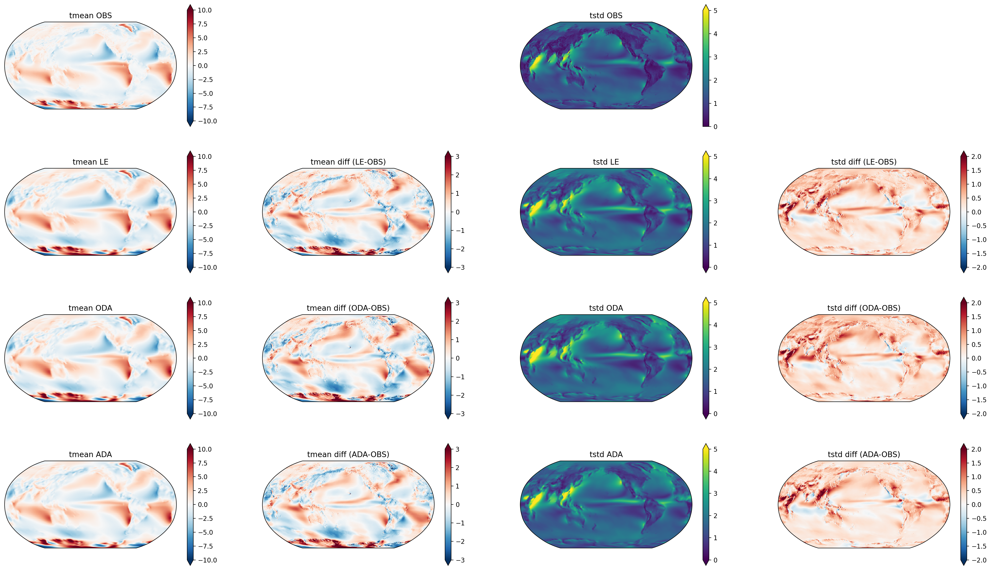

In [40]:
#V


Tf=1
land_feature = cfeature.LAND.with_scale('110m')

projection = ccrs.Robinson(central_longitude=200)
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(28, 16), dpi=200,
                         facecolor='w', edgecolor='k',
                         subplot_kw={'projection': projection},
                         constrained_layout=False)

# === 1열: tmean ===
data_array = cfg_var_V.OBS_ds.mean(dim='time', skipna=True).where(
    ~cfg_var_V.OBS_ds.isnull().any(dim='time'))
data_array['V'].plot.pcolormesh(x='lon', y='lat', ax=axes[0,0],
    transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-10, vmax=10,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
axes[0,0].set_title('tmean OBS')
axes[0,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_V.LE_ds, cfg_var_V.ODA_ds, cfg_var_V.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time')
    data_array['V'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,0],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-10, vmax=10,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,0].set_title(f'tmean {label}')
    axes[i,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 2열: tmean diff ===
obs_mean = cfg_var_V.OBS_ds.mean(dim='time', skipna=True).where(
    ~cfg_var_V.OBS_ds.isnull().any(dim='time'))

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_V.LE_ds, cfg_var_V.ODA_ds, cfg_var_V.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time') - obs_mean
    data_array['V'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,1],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-3, vmax=3,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,1].set_title(f'tmean diff ({label}-OBS)')
    axes[i,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 3열: tstd ===
data_array = cfg_var_V.OBS_ds.std(dim='time', skipna=True).where(
    ~cfg_var_V.OBS_ds.isnull().any(dim='time'))
data_array['V'].plot.pcolormesh(x='lon', y='lat', ax=axes[0,2],
    transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=5,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
axes[0,2].set_title('tstd OBS')
axes[0,2].add_feature(land_feature, facecolor='gray', edgecolor='none')

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_V.LE_ds, cfg_var_V.ODA_ds, cfg_var_V.ADA_ds]):
    data_array = (ds * Tf).std(dim='time')
    data_array['V'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,2],
        transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='both', vmin=0, vmax=5,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,2].set_title(f'tstd {label}')
    axes[i,2].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 4열: tstd diff ===
obs_std = cfg_var_V.OBS_ds.std(dim='time', skipna=True).where(
    ~cfg_var_V.OBS_ds.isnull().any(dim='time'))

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_V.LE_ds, cfg_var_V.ODA_ds, cfg_var_V.ADA_ds]):
    data_array = (ds * Tf).std(dim='time') - obs_std
    data_array['V'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,3],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-2, vmax=2,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,3].set_title(f'tstd diff ({label}-OBS)')
    axes[i,3].add_feature(land_feature, facecolor='gray', edgecolor='none')


axes[0,1].remove()
axes[0,3].remove()

In [57]:
# Read U10

# Read ODA dataset (U10)

start_time = time.time()

cfg_var_U10.ODA_path_load(cfg_var_U10.var)

tmp_comp=cfg_var_U10.comp
cfg_var_U10.ODA_ds = []
# # 2001~2010
# cfg_var_U10.ODA_ds = xr.open_mfdataset(cfg_var_U10.ODA_file_list[0][5][-5:-3], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'U10'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_U10.ODA_ds = xr.open_mfdataset(cfg_var_U10.ODA_file_list[0][5], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'U10'),
                       decode_cf=True, 
                       decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_U10.ODA_ds=cfg_var_U10.ODA_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading ODA, ' + ': ' + str(elapsed_time))



# Read ADA dataset (U10)

start_time = time.time()

cfg_var_U10.ADA_path_load(cfg_var_U10.var)

tmp_comp=cfg_var_U10.comp
cfg_var_U10.ADA_ds = []
# # 2001~2010
# cfg_var_U10.ADA_ds = xr.open_mfdataset(cfg_var_U10.ADA_file_list[0][5][-5:-3], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'U10'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_U10.ADA_ds = xr.open_mfdataset(cfg_var_U10.ADA_file_list[0][5], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'U10'),
                       decode_cf=True, 
                       decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_U10.ADA_ds=cfg_var_U10.ADA_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading ADA, ' + ': ' + str(elapsed_time))



# Read LE dataset (U10)

start_time = time.time()

cfg_var_U10.LE_path_load(cfg_var_U10.var)
# cfg_var_U10.LE_file_list[0][11] # projd 20p1 = 1231.012


tmp_comp=cfg_var_U10.comp
cfg_var_U10.LE_ds = []
# # 2000~2014
# cfg_var_U10.LE_ds = xr.open_mfdataset(cfg_var_U10.LE_file_list[0][11][-3:-2], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'U10'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_U10.LE_ds = xr.open_mfdataset(cfg_var_U10.LE_file_list[0][11], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords_atm_surf(ds, start_date, end_date, 'U10'),
                       decode_cf=True, 
                       decode_times=True)

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_U10.LE_ds=cfg_var_U10.LE_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading LE, ' + ': ' + str(elapsed_time))






cfg_var_U10.OBS_ds['U10'] = np.sqrt(cfg_var_U.OBS_ds['U']**2 + cfg_var_V.OBS_ds['V']**2)
# cfg_var_U10.OBS_ds = cfg_var_U10.OBS_ds.rename({cfg_var_U10.OBS_var: cfg_var_U10.var})



elasped time for reading ODA, : 25.764684677124023
elasped time for reading ADA, : 21.92955780029297
elasped time for reading LE, : 20.377341508865356


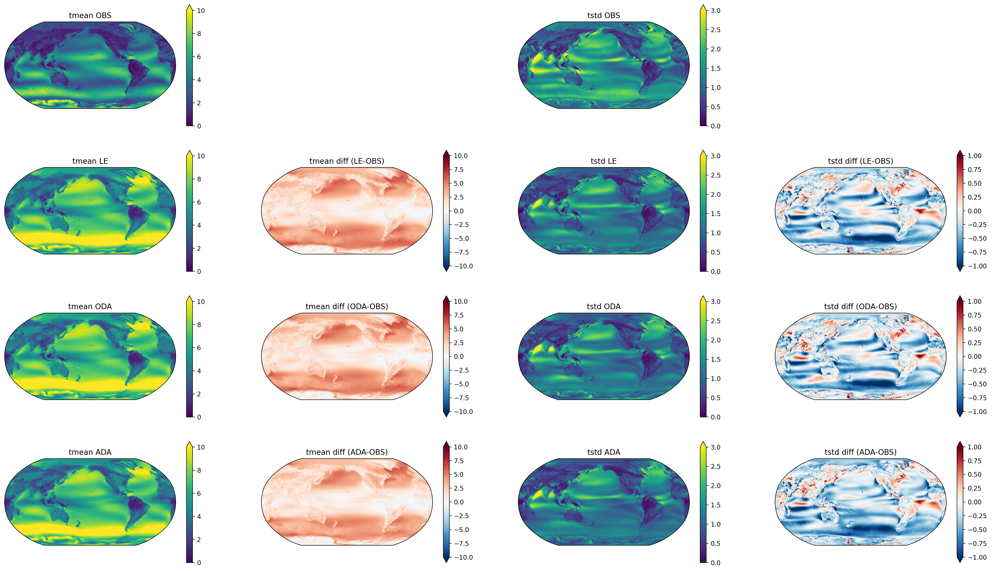

In [61]:
#U10


Tf=1
land_feature = cfeature.LAND.with_scale('110m')

projection = ccrs.Robinson(central_longitude=200)
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(28, 16), dpi=200,
                         facecolor='w', edgecolor='k',
                         subplot_kw={'projection': projection},
                         constrained_layout=False)

# === 1열: tmean ===
data_array = cfg_var_U10.OBS_ds.mean(dim='time', skipna=True).where(
    ~cfg_var_U10.OBS_ds.isnull().any(dim='time'))
data_array.plot.pcolormesh(x='lon', y='lat', ax=axes[0,0],
    transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=10,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
axes[0,0].set_title('tmean OBS')
axes[0,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_U10.LE_ds, cfg_var_U10.ODA_ds, cfg_var_U10.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time')
    data_array['U10'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,0],
        transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=10,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,0].set_title(f'tmean {label}')
    axes[i,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 2열: tmean diff ===
obs_mean = cfg_var_U10.OBS_ds.mean(dim='time', skipna=True).where(
    ~cfg_var_U10.OBS_ds.isnull().any(dim='time'))

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_U10.LE_ds, cfg_var_U10.ODA_ds, cfg_var_U10.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time') - obs_mean
    data_array['U10'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,1],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-10, vmax=10,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,1].set_title(f'tmean diff ({label}-OBS)')
    axes[i,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 3열: tstd ===
data_array = cfg_var_U10.OBS_ds.std(dim='time', skipna=True).where(
    ~cfg_var_U10.OBS_ds.isnull().any(dim='time'))
data_array.plot.pcolormesh(x='lon', y='lat', ax=axes[0,2],
    transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=3,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
axes[0,2].set_title('tstd OBS')
axes[0,2].add_feature(land_feature, facecolor='gray', edgecolor='none')

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_U10.LE_ds, cfg_var_U10.ODA_ds, cfg_var_U10.ADA_ds]):
    data_array = (ds * Tf).std(dim='time')
    data_array['U10'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,2],
        transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=3,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,2].set_title(f'tstd {label}')
    axes[i,2].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 4열: tstd diff ===
obs_std = cfg_var_U10.OBS_ds.std(dim='time', skipna=True).where(
    ~cfg_var_U10.OBS_ds.isnull().any(dim='time'))

for i, label, ds in zip([1, 2, 3], ['LE', 'ODA', 'ADA'],
                        [cfg_var_U10.LE_ds, cfg_var_U10.ODA_ds, cfg_var_U10.ADA_ds]):
    data_array = (ds * Tf).std(dim='time') - obs_std
    data_array['U10'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,3],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-1, vmax=1,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,3].set_title(f'tstd diff ({label}-OBS)')
    axes[i,3].add_feature(land_feature, facecolor='gray', edgecolor='none')


axes[0,1].remove()
axes[0,3].remove()

In [63]:
# Read HBLT

# Read ODA dataset (HBLT)

start_time = time.time()

cfg_var_HBLT.ODA_path_load(cfg_var_HBLT.var)

tmp_comp=cfg_var_HBLT.comp
cfg_var_HBLT.ODA_ds = []
# # 2001~2010
# cfg_var_HBLT.ODA_ds = xr.open_mfdataset(cfg_var_HBLT.ODA_file_list[0][5][-5:-3], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords(ds, start_date, end_date, 'HBLT'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_HBLT.ODA_ds = xr.open_mfdataset(cfg_var_HBLT.ODA_file_list[0][5], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords(ds, start_date, end_date, 'HBLT'),
                       decode_cf=True, 
                       decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_HBLT.ODA_ds=cfg_var_HBLT.ODA_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading ODA, ' + ': ' + str(elapsed_time))



# Read ADA dataset (HBLT)

start_time = time.time()

cfg_var_HBLT.ADA_path_load(cfg_var_HBLT.var)

tmp_comp=cfg_var_HBLT.comp
cfg_var_HBLT.ADA_ds = []
# # 2001~2010
# cfg_var_HBLT.ADA_ds = xr.open_mfdataset(cfg_var_HBLT.ADA_file_list[0][5][-5:-3], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords(ds, start_date, end_date, 'HBLT'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_HBLT.ADA_ds = xr.open_mfdataset(cfg_var_HBLT.ADA_file_list[0][5], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords(ds, start_date, end_date, 'HBLT'),
                       decode_cf=True, 
                       decode_times=True)
    

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_HBLT.ADA_ds=cfg_var_HBLT.ADA_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading ADA, ' + ': ' + str(elapsed_time))

# Read LE dataset (HBLT)

start_time = time.time()

cfg_var_HBLT.LE_path_load(cfg_var_HBLT.var)
# cfg_var_HBLT.LE_file_list[0][11] # projd 20p1 = 1231.012


tmp_comp=cfg_var_HBLT.comp
cfg_var_HBLT.LE_ds = []
# # 2000~2014
# cfg_var_HBLT.LE_ds = xr.open_mfdataset(cfg_var_HBLT.LE_file_list[0][11][-3:-2], 
#                        chunks={'time': 5}, 
#                        combine='nested',
#                        parallel=True,
#                        preprocess=lambda ds: process_coords(ds, start_date, end_date, 'HBLT'),
#                        decode_cf=True, 
#                        decode_times=True)
# all years
cfg_var_HBLT.LE_ds = xr.open_mfdataset(cfg_var_HBLT.LE_file_list[0][11], 
                       chunks={'time': 5}, 
                       combine='nested',
                       parallel=True,
                       preprocess=lambda ds: process_coords(ds, start_date, end_date, 'HBLT'),
                       decode_cf=True, 
                       decode_times=True)

end_time = time.time()
elapsed_time = end_time - start_time

cfg_var_HBLT.LE_ds=cfg_var_HBLT.LE_ds.compute()

end_time = time.time()
elapsed_time = end_time - start_time
print('elasped time for reading LE, ' + ': ' + str(elapsed_time))

elasped time for reading ODA, : 20.02099347114563
elasped time for reading ADA, : 9.23528003692627
elasped time for reading LE, : 15.285818576812744


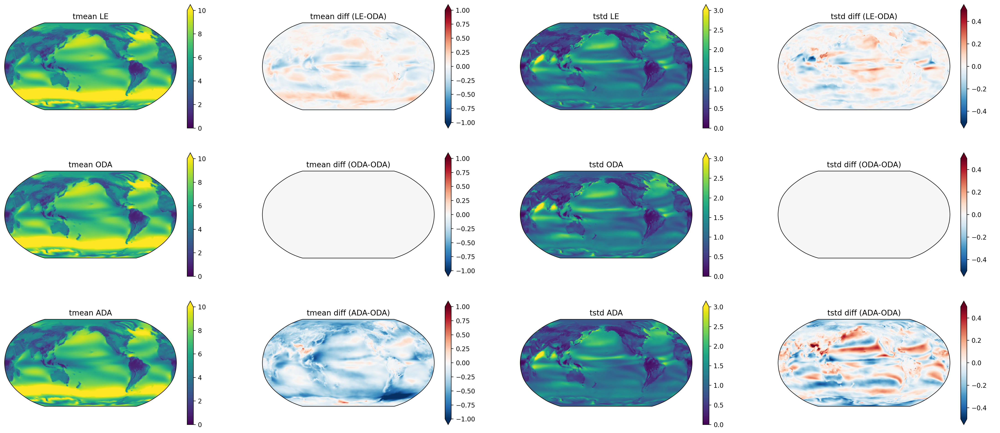

In [80]:
#U10 (models)


Tf=1
land_feature = cfeature.LAND.with_scale('110m')

projection = ccrs.Robinson(central_longitude=200)
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(28, 12), dpi=200,
                         facecolor='w', edgecolor='k',
                         subplot_kw={'projection': projection},
                         constrained_layout=False)

# === 1열: tmean ===

for i, label, ds in zip([0, 1, 2], ['LE', 'ODA', 'ADA'],
                        [cfg_var_U10.LE_ds, cfg_var_U10.ODA_ds, cfg_var_U10.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time')
    data_array['U10'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,0],
        transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=10,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,0].set_title(f'tmean {label}')
    axes[i,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 2열: tmean diff ===
obs_mean = (cfg_var_U10.ODA_ds*Tf).mean(dim='time')

for i, label, ds in zip([0, 1, 2], ['LE', 'ODA', 'ADA'],
                        [cfg_var_U10.LE_ds, cfg_var_U10.ODA_ds, cfg_var_U10.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time') - obs_mean
    data_array['U10'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,1],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-1, vmax=1,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,1].set_title(f'tmean diff ({label}-ODA)')
    axes[i,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 3열: tstd ===

for i, label, ds in zip([0, 1, 2], ['LE', 'ODA', 'ADA'],
                        [cfg_var_U10.LE_ds, cfg_var_U10.ODA_ds, cfg_var_U10.ADA_ds]):
    data_array = (ds * Tf).std(dim='time')
    data_array['U10'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,2],
        transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=3,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,2].set_title(f'tstd {label}')
    axes[i,2].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 4열: tstd diff ===
obs_std = (cfg_var_U10.ODA_ds*Tf).std(dim='time')

for i, label, ds in zip([0, 1, 2], ['LE', 'ODA', 'ADA'],
                        [cfg_var_U10.LE_ds, cfg_var_U10.ODA_ds, cfg_var_U10.ADA_ds]):
    data_array = (ds * Tf).std(dim='time') - obs_std
    data_array['U10'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,3],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-0.5, vmax=0.5,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,3].set_title(f'tstd diff ({label}-ODA)')
    axes[i,3].add_feature(land_feature, facecolor='gray', edgecolor='none')


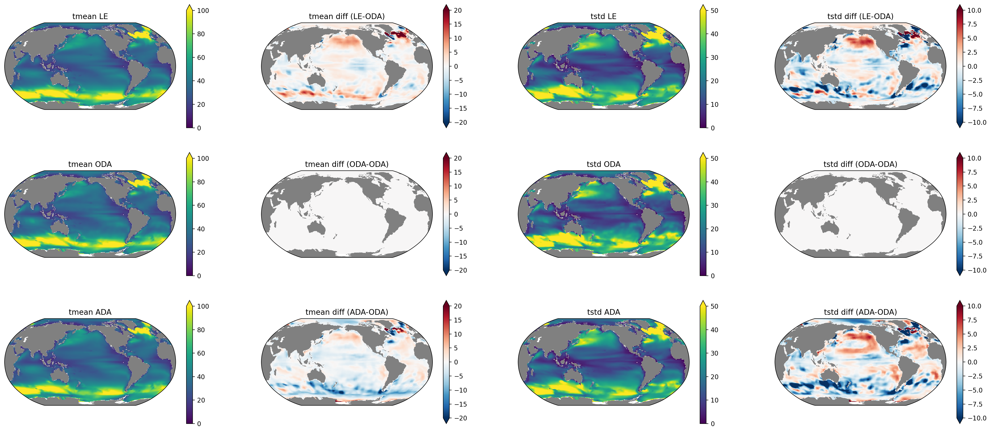

In [77]:
#HBLT (models)


Tf=0.01
land_feature = cfeature.LAND.with_scale('110m')

projection = ccrs.Robinson(central_longitude=200)
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(28, 12), dpi=200,
                         facecolor='w', edgecolor='k',
                         subplot_kw={'projection': projection},
                         constrained_layout=False)

# === 1열: tmean ===

for i, label, ds in zip([0, 1, 2], ['LE', 'ODA', 'ADA'],
                        [cfg_var_HBLT.LE_ds, cfg_var_HBLT.ODA_ds, cfg_var_HBLT.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time')
    data_array['HBLT'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,0],
        transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=100,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,0].set_title(f'tmean {label}')
    axes[i,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 2열: tmean diff ===
obs_mean = (cfg_var_HBLT.ODA_ds*Tf).mean(dim='time')

for i, label, ds in zip([0, 1, 2], ['LE', 'ODA', 'ADA'],
                        [cfg_var_HBLT.LE_ds, cfg_var_HBLT.ODA_ds, cfg_var_HBLT.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time') - obs_mean
    data_array['HBLT'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,1],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-20, vmax=20,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,1].set_title(f'tmean diff ({label}-ODA)')
    axes[i,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 3열: tstd ===

for i, label, ds in zip([0, 1, 2], ['LE', 'ODA', 'ADA'],
                        [cfg_var_HBLT.LE_ds, cfg_var_HBLT.ODA_ds, cfg_var_HBLT.ADA_ds]):
    data_array = (ds * Tf).std(dim='time')
    data_array['HBLT'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,2],
        transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=50,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,2].set_title(f'tstd {label}')
    axes[i,2].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 4열: tstd diff ===
obs_std = (cfg_var_HBLT.ODA_ds*Tf).std(dim='time')

for i, label, ds in zip([0, 1, 2], ['LE', 'ODA', 'ADA'],
                        [cfg_var_HBLT.LE_ds, cfg_var_HBLT.ODA_ds, cfg_var_HBLT.ADA_ds]):
    data_array = (ds * Tf).std(dim='time') - obs_std
    data_array['HBLT'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,3],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-10, vmax=10,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,3].set_title(f'tstd diff ({label}-ODA)')
    axes[i,3].add_feature(land_feature, facecolor='gray', edgecolor='none')


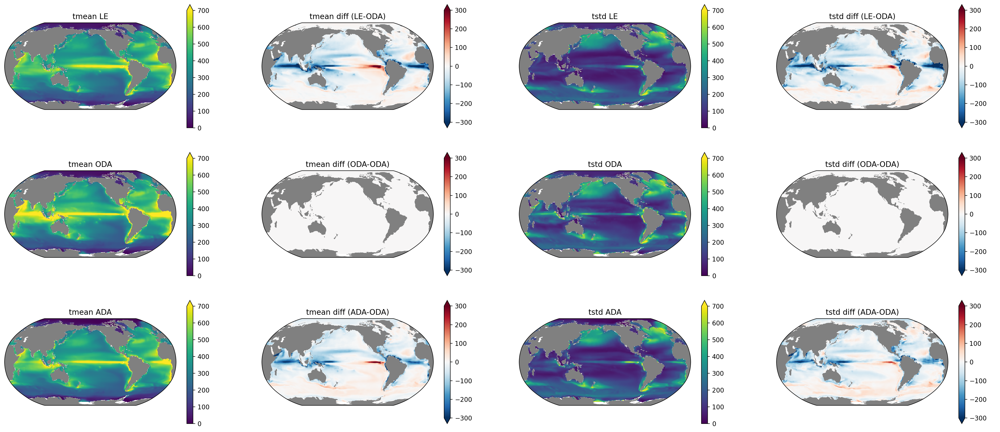

In [84]:
#photoC_TOT_zint_100m (models)



Tf=10368
land_feature = cfeature.LAND.with_scale('110m')

projection = ccrs.Robinson(central_longitude=200)
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(28, 12), dpi=200,
                         facecolor='w', edgecolor='k',
                         subplot_kw={'projection': projection},
                         constrained_layout=False)

# === 1열: tmean ===

for i, label, ds in zip([0, 1, 2], ['LE', 'ODA', 'ADA'],
                        [cfg_var_photoC_TOT_zint_100m.LE_ds, cfg_var_photoC_TOT_zint_100m.ODA_ds, cfg_var_photoC_TOT_zint_100m.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time')
    data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,0],
        transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=700,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,0].set_title(f'tmean {label}')
    axes[i,0].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 2열: tmean diff ===
obs_mean = (cfg_var_photoC_TOT_zint_100m.ODA_ds*Tf).mean(dim='time')

for i, label, ds in zip([0, 1, 2], ['LE', 'ODA', 'ADA'],
                        [cfg_var_photoC_TOT_zint_100m.LE_ds, cfg_var_photoC_TOT_zint_100m.ODA_ds, cfg_var_photoC_TOT_zint_100m.ADA_ds]):
    data_array = (ds * Tf).mean(dim='time') - obs_mean
    data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,1],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-300, vmax=300,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,1].set_title(f'tmean diff ({label}-ODA)')
    axes[i,1].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 3열: tstd ===

for i, label, ds in zip([0, 1, 2], ['LE', 'ODA', 'ADA'],
                        [cfg_var_photoC_TOT_zint_100m.LE_ds, cfg_var_photoC_TOT_zint_100m.ODA_ds, cfg_var_photoC_TOT_zint_100m.ADA_ds]):
    data_array = (ds * Tf).std(dim='time')
    data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,2],
        transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=700,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,2].set_title(f'tstd {label}')
    axes[i,2].add_feature(land_feature, facecolor='gray', edgecolor='none')

# === 4열: tstd diff ===
obs_std = (cfg_var_photoC_TOT_zint_100m.ODA_ds*Tf).std(dim='time')

for i, label, ds in zip([0, 1, 2], ['LE', 'ODA', 'ADA'],
                        [cfg_var_photoC_TOT_zint_100m.LE_ds, cfg_var_photoC_TOT_zint_100m.ODA_ds, cfg_var_photoC_TOT_zint_100m.ADA_ds]):
    data_array = (ds * Tf).std(dim='time') - obs_std
    data_array['photoC_TOT_zint_100m'].plot.pcolormesh(x='lon', y='lat', ax=axes[i,3],
        transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, extend='both', vmin=-300, vmax=300,
        cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'})
    axes[i,3].set_title(f'tstd diff ({label}-ODA)')
    axes[i,3].add_feature(land_feature, facecolor='gray', edgecolor='none')


In [108]:

# to check phyC and zooC for conceptual model

workdir = '/mnt/lustre/proj/earth.system.predictability/ASSM_EXP_timeseries/archive/b.e21.BHISTsmbb.f09_g17.assm.projdv7.3_ba-20p1/ocn/proc/tseries/month_1'

zooCfile = workdir + '/b.e21.BHISTsmbb.f09_g17.assm.projdv7.3_ba-20p1.pop.h.zooC.201001-201412.nc'
diatCfile = workdir + '/b.e21.BHISTsmbb.f09_g17.assm.projdv7.3_ba-20p1.pop.h.diatC.201001-201412.nc'
diazCfile = workdir + '/b.e21.BHISTsmbb.f09_g17.assm.projdv7.3_ba-20p1.pop.h.diazC.201001-201412.nc'
spCfile = workdir + '/b.e21.BHISTsmbb.f09_g17.assm.projdv7.3_ba-20p1.pop.h.spC.201001-201412.nc'
NO3file = workdir + '/b.e21.BHISTsmbb.f09_g17.assm.projdv7.3_ba-20p1.pop.h.NO3.201001-201412.nc' #mmol/m^3
Fefile = workdir + '/b.e21.BHISTsmbb.f09_g17.assm.projdv7.3_ba-20p1.pop.h.Fe.201001-201412.nc'
PO4file = workdir + '/b.e21.BHISTsmbb.f09_g17.assm.projdv7.3_ba-20p1.pop.h.PO4.201001-201412.nc'

Tf=0.01201 # mmol/m^3 -> gC/m^3

temp_zooC = xr.open_mfdataset(zooCfile,
                           preprocess=lambda ds: process_coords_bgc_surface(ds, start_date, end_date, 'zooC')) * Tf
temp_diatC = xr.open_mfdataset(diatCfile,
                           preprocess=lambda ds: process_coords_bgc_surface(ds, start_date, end_date, 'diatC')) * Tf
temp_diazC = xr.open_mfdataset(diazCfile,
                           preprocess=lambda ds: process_coords_bgc_surface(ds, start_date, end_date, 'diazC')) * Tf
temp_spC = xr.open_mfdataset(spCfile,
                           preprocess=lambda ds: process_coords_bgc_surface(ds, start_date, end_date, 'spC')) * Tf

temp_phyC['phyC'] = temp_diatC['diatC'] + temp_diazC['diazC'] + temp_spC['spC']





In [112]:
temp_phyC

<xarray.DataArray (time: 60, lat: 180, lon: 360)> Size: 16MB
array([[[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [0.02973455, 0.02971543, 0.02971543, ..., 0.0297359 ,
         0.0297359 , 0.02973455],
        [0.02969791, 0.02969791, 0.02969791, ..., 0.02969791,
         0.02969791, 0.02969791],
        [0.02967479, 0.02967479, 0.02967479, ..., 0.02967479,
         0.02967479, 0.02967479]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
...
        [0.03031067, 0.03026216, 0.03026216, ..., 0.03030432,
         0.03030432, 0.03031067],
        [0.03021325, 0.03021325, 0.03021325, ..., 0.03021325,
         0.03021325, 0.03021325],
        [0.03017976, 0.03017976, 0.03017976, ..., 0.03017976,
         0.03017976, 0.03017976]],

       [[       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        [       nan,        nan,        nan, ...,        nan,
                nan,        nan],
        ...,
        [0.02990388, 0.02989752, 0.02989752, ..., 0.02990561,
         0.02990561, 0.02990388],
        [0.0298942 , 0.0298942 , 0.0298942 , ..., 0.0298942 ,
         0.0298942 , 0.0298942 ],
        [0.02988871, 0.02988871, 0.02988871, ..., 0.02988871,
         0.02988871, 0.02988871]]], dtype=float32)
Coordinates:
  * time     (time) object 480B 2010-02-01 00:00:00 ... 2015-01-01 00:00:00
  * lat      (lat) float64 1kB -90.0 -89.0 -88.0 -87.0 ... 86.0 87.0 88.0 89.0
  * lon      (lon) float64 3kB -180.0 -179.0 -178.0 -177.0 ... 177.0 178.0 179.0
    phyC     (time, lat, lon) float32 16MB nan nan nan ... 0.000359 0.000359

Text(0.5, 1.0, 'Mean phyC/zooC')

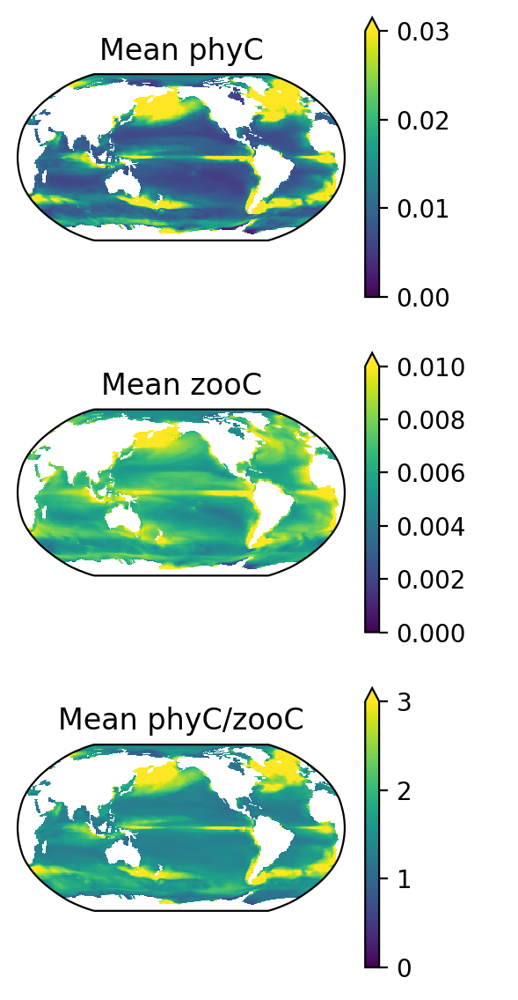

In [129]:
fig, ax = plt.subplots(nrows=3, ncols=1, subplot_kw={'projection': projection}, figsize=(3, 7), dpi=200)



data_array = temp_phyC['phyC (gC/m^3)']

data_array.mean(dim='time').plot.pcolormesh(
    x='lon', y='lat', ax=ax[0],
    transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=0.03,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'}
)
ax[0].set_title('Mean phyC')



data_array = temp_zooC['zooC (gC/m^3)']
data_array.mean(dim='time').plot.pcolormesh(
    x='lon', y='lat', ax=ax[1],
    transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=0.01,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'}
)
ax[1].set_title('Mean zooC')


data_array = temp_phyC['phyC']/temp_zooC['zooC']
data_array.mean(dim='time').plot.pcolormesh(
    x='lon', y='lat', ax=ax[2],
    transform=ccrs.PlateCarree(), cmap='viridis', add_colorbar=True, extend='max', vmin=0, vmax=3,
    cbar_kwargs={'orientation':'vertical', "label": " ", 'spacing': 'proportional'}
)
ax[2].set_title('Mean phyC/zooC')

In [119]:
data_array.mean(dim='time')

<xarray.DataArray (lat: 180, lon: 360)> Size: 259kB
array([[      nan,       nan,       nan, ...,       nan,       nan,
              nan],
       [      nan,       nan,       nan, ...,       nan,       nan,
              nan],
       [      nan,       nan,       nan, ...,       nan,       nan,
              nan],
       ...,
       [1.3741393, 1.3780571, 1.3780571, ..., 1.3774455, 1.3774455,
        1.3741393],
       [1.3943106, 1.3943106, 1.3943106, ..., 1.3943106, 1.3943106,
        1.3943106],
       [1.4365858, 1.4365858, 1.4365858, ..., 1.4365858, 1.4365858,
        1.4365858]], dtype=float32)
Coordinates:
  * lat      (lat) float64 1kB -90.0 -89.0 -88.0 -87.0 ... 86.0 87.0 88.0 89.0
  * lon      (lon) float64 3kB -180.0 -179.0 -178.0 -177.0 ... 177.0 178.0 179.0